In [49]:
import pandas as pd
import seaborn as sns
import plotly
import plotly.express as px
plotly.offline.init_notebook_mode(connected=True)

# Datasets

In [50]:
DE__WT__Dpf_3_null_path = "../results/DE__WT__Dpf_3_null/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"
DE__WT__mut_2_path = "../results/DE__WT__mut_2/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"
DE__WT__mut_7_path = "../results/DE__WT__mut_7/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"

# Functions

In [51]:
def ma_plot(path, title):
    df = pd.read_csv(path, header=0, sep="\t")
    
    df.loc[df["transposon"].isna(), "transposon"] = "No info"
    df.loc[df["transposon_family"].isna(), "transposon_family"] = "No info"
    df.loc[df["transposon_class"].isna(), "transposon_class"] = "No info"

    df["transposon_overlap"] = "No"
    df.loc[~(df["transposon"]=="No info"), "transposon_overlap"] = "Yes"
    
    df["Mark"] = "All genes"
    df.loc[df["FDR"]<0.05, "Mark"] = "FDR<0.05"
    df.loc[(df["FDR"]<0.05) & (df["transposon_overlap"]=="No"), "Mark"] = "FDR<0.05\nNo transposon overlap"
    df.loc[(df["FDR"]<0.05) & (df["transposon_overlap"]=="Yes"), "Mark"] = "FDR<0.05\nTransposon overlap"
    
    fig = px.scatter(df,
                 x="logCPM",
                 y="logFC",
                 color="Mark",
                 hover_name="id",
                 hover_data=["id", "gene_biotype", "transposon", "transposon_family", "transposon_class", "FDR", "Mark"],
                 title = title,
                 width=1024, height=1024)
    
    print(df["Mark"].value_counts())
    
    fig.show()
    
    return df

# Results

All genes                          20183
FDR<0.05\nTransposon overlap        2546
FDR<0.05\nNo transposon overlap     2205
Name: Mark, dtype: int64


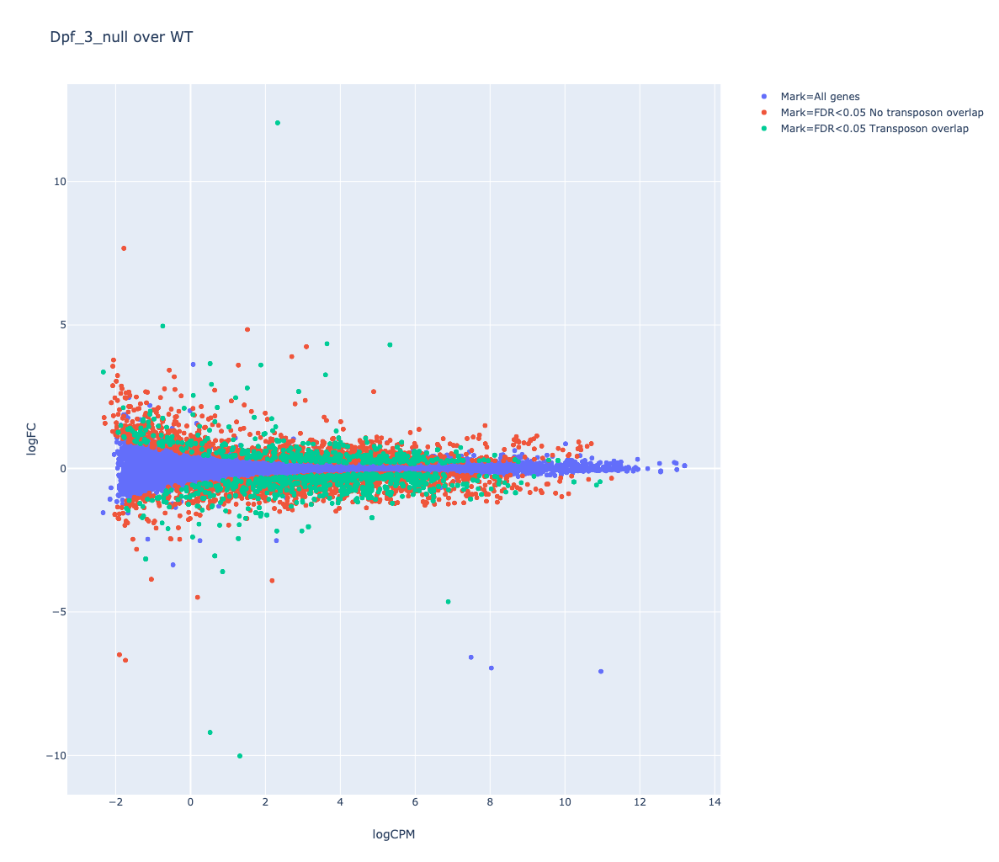

In [52]:
DE__WT__Dpf_3_null = ma_plot(DE__WT__Dpf_3_null_path, "Dpf_3_null over WT")

All genes                          13065
FDR<0.05\nTransposon overlap        6862
FDR<0.05\nNo transposon overlap     6057
Name: Mark, dtype: int64


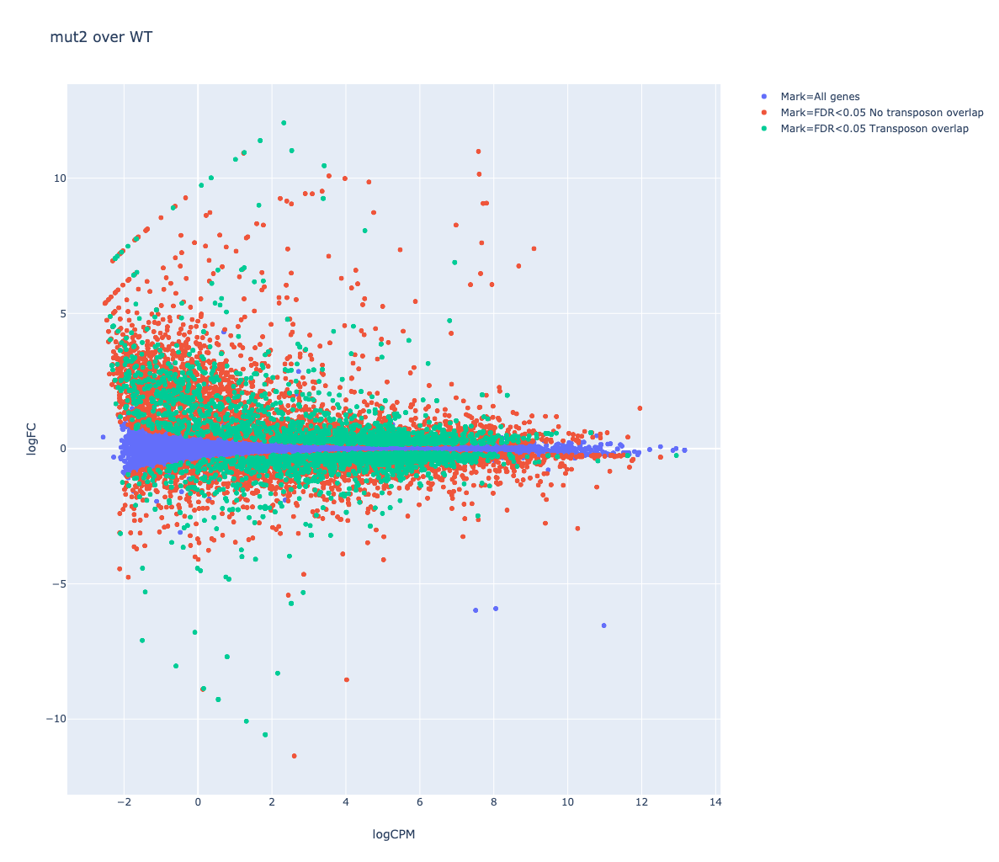

In [53]:
DE__WT__mut_2 = ma_plot(DE__WT__mut_2_path, "mut2 over WT")

All genes                          11989
FDR<0.05\nTransposon overlap        7861
FDR<0.05\nNo transposon overlap     6521
Name: Mark, dtype: int64


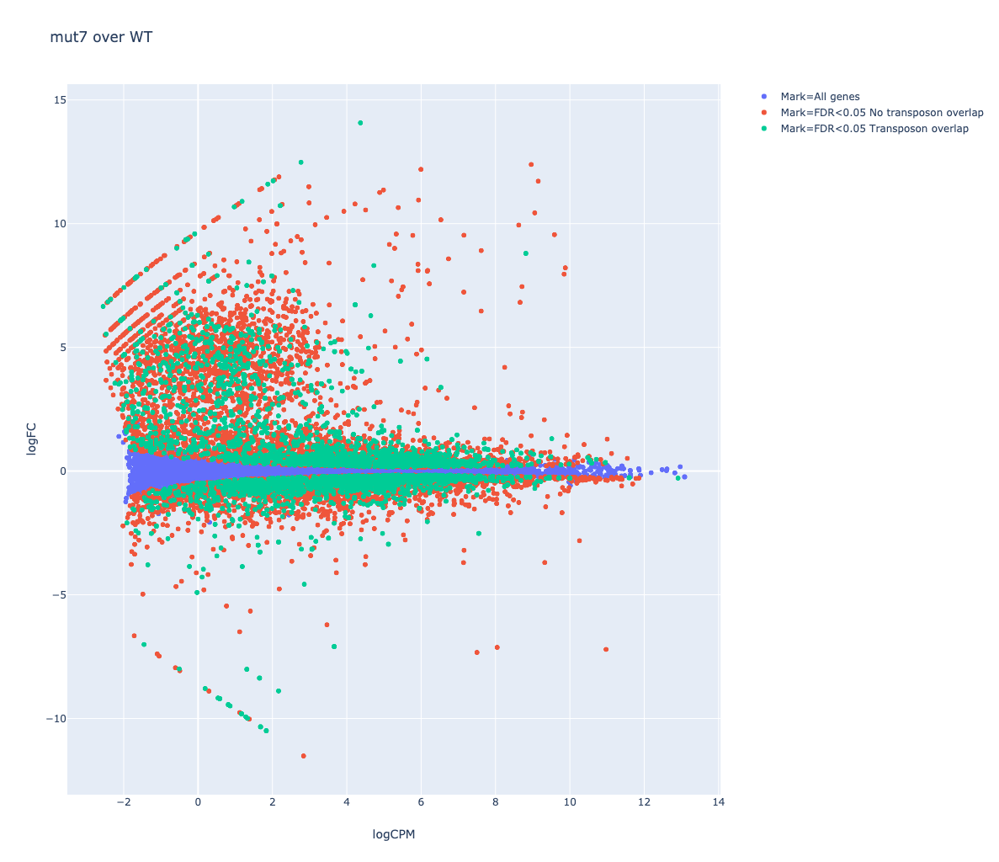

In [54]:
DE__WT__mut_7 = ma_plot(DE__WT__mut_7_path, "mut7 over WT")